In [ ]:
## Force reinstall latest version of Kaggle
!pip install --upgrade --force-reinstall --no-deps kaggle

     |████████████████████████████████| 58 kB 2.2 MB/s 
  Created wheel for kaggle: filename=kaggle-1.5.12-py3-none-any.whl size=73051 sha256=5b9c1cb1df8f5fd3d1c669c97fd48aa394795ca8161bb2768313ebd635f8b058
  Stored in directory: /root/.cache/pip/wheels/62/d6/58/5853130f941e75b2177d281eb7e44b4a98ed46dd155f556dc5
Successfully built kaggle
  Attempting uninstall: kaggle
    Found existing installation: kaggle 1.5.12
    Uninstalling kaggle-1.5.12:
      Successfully uninstalled kaggle-1.5.12


In [ ]:
from google.colab import files

## Upload kaggle api token
files.upload()

! mkdir ~/.kaggle
! cp kaggle.json ~/.kaggle/
! chmod 600 ~/.kaggle/kaggle.json

Saving kaggle.json to kaggle.json


In [ ]:
## Download data
! kaggle datasets download -d alexteboul/heart-disease-health-indicators-dataset

  0% 0.00/2.66M [00:00<?, ?B/s]
100% 2.66M/2.66M [00:00<00:00, 127MB/s]


In [ ]:
! ls

heart-disease-health-indicators-dataset.zip  kaggle.json  sample_data


In [ ]:
## Unzip

! mkdir heart_disease
! unzip heart-disease-health-indicators-dataset.zip -d heart_disease

Archive:  heart-disease-health-indicators-dataset.zip
  inflating: heart_disease/heart_disease_health_indicators_BRFSS2015.csv  


In [ ]:
## Install LIME
!pip install lime

     |████████████████████████████████| 275 kB 5.1 MB/s 
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283857 sha256=71065601cd70144ca3fcd26c81423ab332543a911f9ae282bfaecb8d8f8ebee5
  Stored in directory: /root/.cache/pip/wheels/ca/cb/e5/ac701e12d365a08917bf4c6171c0961bc880a8181359c66aa7
Successfully built lime


In [ ]:
## Install DiCE
!pip install dice_ml

     |████████████████████████████████| 242 kB 5.0 MB/s 


In [ ]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import time

from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import NearMiss, TomekLinks
from imblearn.pipeline import Pipeline
#from imblearn.pipeline import make_pipeline as imb_make_pipeline
from imblearn.combine import SMOTETomek

#from sklearn.preprocessing import StandardScaler, RobustScaler
from sklearn.preprocessing import MinMaxScaler

from sklearn.model_selection import StratifiedShuffleSplit, StratifiedKFold, RandomizedSearchCV, cross_val_score

from sklearn.utils.fixes import loguniform

#from sklearn.naive_bayes import GaussianNB
from sklearn.naive_bayes import CategoricalNB
from sklearn.linear_model import LogisticRegression, SGDClassifier
from sklearn.svm import LinearSVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, BaggingClassifier
from sklearn.neural_network import MLPClassifier

from sklearn.calibration import CalibratedClassifierCV

from sklearn.metrics import confusion_matrix, auc, roc_auc_score, recall_score, precision_score, accuracy_score, f1_score, classification_report, average_precision_score, matthews_corrcoef, precision_recall_curve, make_scorer

import lime
from lime.lime_tabular import LimeTabularExplainer

import dice_ml

In [ ]:
import warnings
warnings.filterwarnings("ignore")

In [ ]:
pd.set_option('display.max_columns', 500)

# Data Exploration

##Feature explanations:

###Response Variable / Dependent Variable:

* Respondents that have ever reported having coronary heart disease (CHD) or myocardial infarction (MI) --> _MICHD

###Independent Variables:

* High Blood Pressure
  * Adults who have been told they have high blood pressure by a doctor, nurse, or other health professional --> _RFHYPE5

* High Cholesterol
 * Have you EVER been told by a doctor, nurse or other health professional that your blood cholesterol is high? --> TOLDHI2
 * Cholesterol check within past five years --> _CHOLCHK

* BMI
 * Body Mass Index (BMI) --> _BMI5

* Smoking
 * Have you smoked at least 100 cigarettes in your entire life? [Note: 5 packs = 100 cigarettes] --> SMOKE100 (Original dataset contains information determining CURRENT smokers, which this feature does not indicate)

* Other Chronic Health Conditions
 * (Ever told) you had a stroke. --> CVDSTRK3
 * (Ever told) you have diabetes (If "Yes" and respondent is female, ask "Was this only when you were pregnant?". If Respondent says pre-diabetes or borderline diabetes, use response code 4.) --> DIABETE3

* Physical Activity
 * Adults who reported doing physical activity or exercise during the past 30 days other than their regular job --> _TOTINDA

* Diet
 * Consume Fruit 1 or more times per day --> _FRTLT1
 * Consume Vegetables 1 or more times per day --> _VEGLT1

* Alcohol Consumption
 * Heavy drinkers (adult men having more than 14 drinks per week and adult women having more than 7 drinks per week) --> _RFDRHV5

* Health Care
 * Do you have any kind of health care coverage, including health insurance, prepaid plans such as HMOs, or government plans such as Medicare, or Indian Health Service? --> HLTHPLN1
 * Was there a time in the past 12 months when you needed to see a doctor but could not because of cost? --> MEDCOST

* Health General and Mental Health
 * Would you say that in general your health is: --> GENHLTH
 * Now thinking about your mental health, which includes stress, depression, and problems with emotions, for how many days during the past 30 days was your mental health not good? --> MENTHLTH
 * Now thinking about your physical health, which includes physical illness and injury, for how many days during the past 30 days was your physical health not good? --> PHYSHLTH
 * Do you have serious difficulty walking or climbing stairs? --> DIFFWALK

* Demographics
 * Indicate sex of respondent. --> SEX
 * Fourteen-level age category --> _AGEG5YR
 * What is the highest grade or year of school you completed? --> EDUCA
 * Is your annual household income from all sources: (If respondent refuses at any income level, code "Refused.") --> INCOME2

## Notes:
253680 observations, imbalanced.


Ordinal Features:
*   BMI - follow ordinal categories as denoted by [Health Canada](https://www.canada.ca/en/health-canada/services/food-nutrition/healthy-eating/healthy-weights/canadian-guidelines-body-weight-classification-adults/body-mass-index-nomogram.html).
*   MentHlth and PhysHlth - 0 to 30 days of mental or physical health issues in last 30 days. This is actually numerical - should be scaled?
*   GenHlth - 1 is Excellent -> 5 is Poor (should be reversed) - 0 is Poor -> 4 is Excellent
*   Diabetes - 0 is for no diabetes or only during pregnancy, 1 is for pre-diabetes or borderline diabetes, 2 is for yes diabetes
*   Age - 1 is 18-24 all the way up to 13 which is 80 and older. 5 year increments.
*   Education - 1 being never attended school or kindergarten only, up to 6 being college for 4 years or more
*   Income - 1 being less than \$10,000 all the way up to 8 being \$75,000 or more






In [ ]:
heartdisease_df = pd.read_csv('/content/heart_disease/heart_disease_health_indicators_BRFSS2015.csv')
heartdisease_df.head()

,HeartDiseaseorAttack,HighBP,HighChol,CholCheck,BMI,Smoker,Stroke,Diabetes,PhysActivity,Fruits,Veggies,HvyAlcoholConsump,AnyHealthcare,NoDocbcCost,GenHlth,MentHlth,PhysHlth,DiffWalk,Sex,Age,Education,Income
0,0.0,1.0,1.0,1.0,40.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,5.0,18.0,15.0,1.0,0.0,9.0,4.0,3.0
1,0.0,0.0,0.0,0.0,25.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,3.0,0.0,0.0,0.0,0.0,7.0,6.0,1.0
2,0.0,1.0,1.0,1.0,28.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,5.0,30.0,30.0,1.0,0.0,9.0,4.0,8.0
3,0.0,1.0,0.0,1.0,27.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,1.0,0.0,2.0,0.0,0.0,0.0,0.0,11.0,3.0,6.0
4,0.0,1.0,1.0,1.0,24.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,1.0,0.0,2.0,3.0,0.0,0.0,0.0,11.0,5.0,4.0


In [ ]:
heartdisease_df['GenHlth'] = 5 - heartdisease_df['GenHlth']
heartdisease_df.head()

,HeartDiseaseorAttack,HighBP,HighChol,CholCheck,BMI,Smoker,Stroke,Diabetes,PhysActivity,Fruits,Veggies,HvyAlcoholConsump,AnyHealthcare,NoDocbcCost,GenHlth,MentHlth,PhysHlth,DiffWalk,Sex,Age,Education,Income
0,0.0,1.0,1.0,1.0,40.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,18.0,15.0,1.0,0.0,9.0,4.0,3.0
1,0.0,0.0,0.0,0.0,25.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,2.0,0.0,0.0,0.0,0.0,7.0,6.0,1.0
2,0.0,1.0,1.0,1.0,28.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,30.0,30.0,1.0,0.0,9.0,4.0,8.0
3,0.0,1.0,0.0,1.0,27.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,1.0,0.0,3.0,0.0,0.0,0.0,0.0,11.0,3.0,6.0
4,0.0,1.0,1.0,1.0,24.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,1.0,0.0,3.0,3.0,0.0,0.0,0.0,11.0,5.0,4.0


In [ ]:
pd.set_option("display.float", "{:.2f}".format)
heartdisease_df[heartdisease_df.columns.to_list()].describe()

,HeartDiseaseorAttack,HighBP,HighChol,CholCheck,BMI,Smoker,Stroke,Diabetes,PhysActivity,Fruits,Veggies,HvyAlcoholConsump,AnyHealthcare,NoDocbcCost,GenHlth,MentHlth,PhysHlth,DiffWalk,Sex,Age,Education,Income
count,253680.00,253680.00,253680.00,253680.00,253680.00,253680.00,253680.00,253680.00,253680.00,253680.00,253680.00,253680.00,253680.00,253680.00,253680.00,253680.00,253680.00,253680.00,253680.00,253680.00,253680.00,253680.00
mean,0.09,0.43,0.42,0.96,28.38,0.44,0.04,0.30,0.76,0.63,0.81,0.06,0.95,0.08,2.49,3.18,4.24,0.17,0.44,8.03,5.05,6.05
std,0.29,0.49,0.49,0.19,6.61,0.50,0.20,0.70,0.43,0.48,0.39,0.23,0.22,0.28,1.07,7.41,8.72,0.37,0.50,3.05,0.99,2.07
min,0.00,0.00,0.00,0.00,12.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,1.00,1.00
25%,0.00,0.00,0.00,1.00,24.00,0.00,0.00,0.00,1.00,0.00,1.00,0.00,1.00,0.00,2.00,0.00,0.00,0.00,0.00,6.00,4.00,5.00
50%,0.00,0.00,0.00,1.00,27.00,0.00,0.00,0.00,1.00,1.00,1.00,0.00,1.00,0.00,3.00,0.00,0.00,0.00,0.00,8.00,5.00,7.00
75%,0.00,1.00,1.00,1.00,31.00,1.00,0.00,0.00,1.00,1.00,1.00,0.00,1.00,0.00,3.00,2.00,3.00,0.00,1.00,10.00,6.00,8.00
max,1.00,1.00,1.00,1.00,98.00,1.00,1.00,2.00,1.00,1.00,1.00,1.00,1.00,1.00,4.00,30.00,30.00,1.00,1.00,13.00,6.00,8.00


Class 0 (No HD/HA)
Count:  229787
Percentage of dataset:  90.58 %

Class 1 (HD/HA)
Count:  23893
Percentage of dataset:  9.42 %


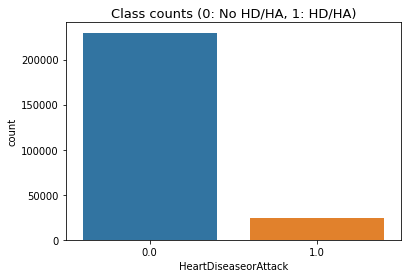

In [ ]:
sns.countplot(x='HeartDiseaseorAttack', data=heartdisease_df)
plt.title('Class counts (0: No HD/HA, 1: HD/HA)', fontsize=13)

print('Class 0 (No HD/HA)\nCount: ', heartdisease_df['HeartDiseaseorAttack'].value_counts()[0])
print('Percentage of dataset: ', round(heartdisease_df['HeartDiseaseorAttack'].value_counts()[0]/len(heartdisease_df) * 100,2), '%')

print('\nClass 1 (HD/HA)\nCount: ', heartdisease_df['HeartDiseaseorAttack'].value_counts()[1])
print('Percentage of dataset: ', round(heartdisease_df['HeartDiseaseorAttack'].value_counts()[1]/len(heartdisease_df) * 100,2), '%')

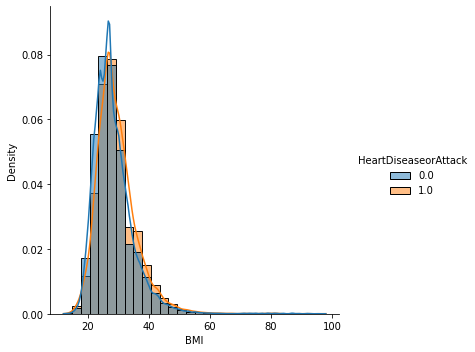

In [ ]:
sns.displot(x = "BMI", data=heartdisease_df, kde=True, bins=30, stat="density", hue="HeartDiseaseorAttack", common_norm=False)
#plt.title('BMI Density plot', fontsize=13)

Text(0.5, 1.0, 'MentHlth Counts')

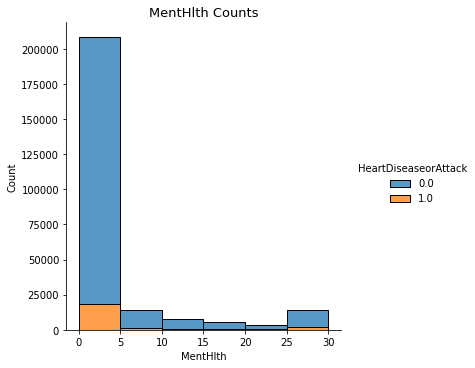

In [ ]:
sns.displot(x = "MentHlth", data=heartdisease_df, bins=6, hue="HeartDiseaseorAttack", multiple="stack")
plt.title('MentHlth Counts', fontsize=13)

Text(0.5, 1.0, 'PhysHlth Counts')

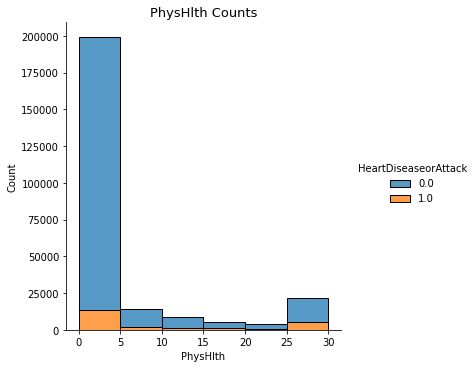

In [ ]:
sns.displot(x = "PhysHlth", data=heartdisease_df, bins=6, hue="HeartDiseaseorAttack", multiple="stack")
plt.title('PhysHlth Counts', fontsize=13)

<Figure size 432x288 with 0 Axes>

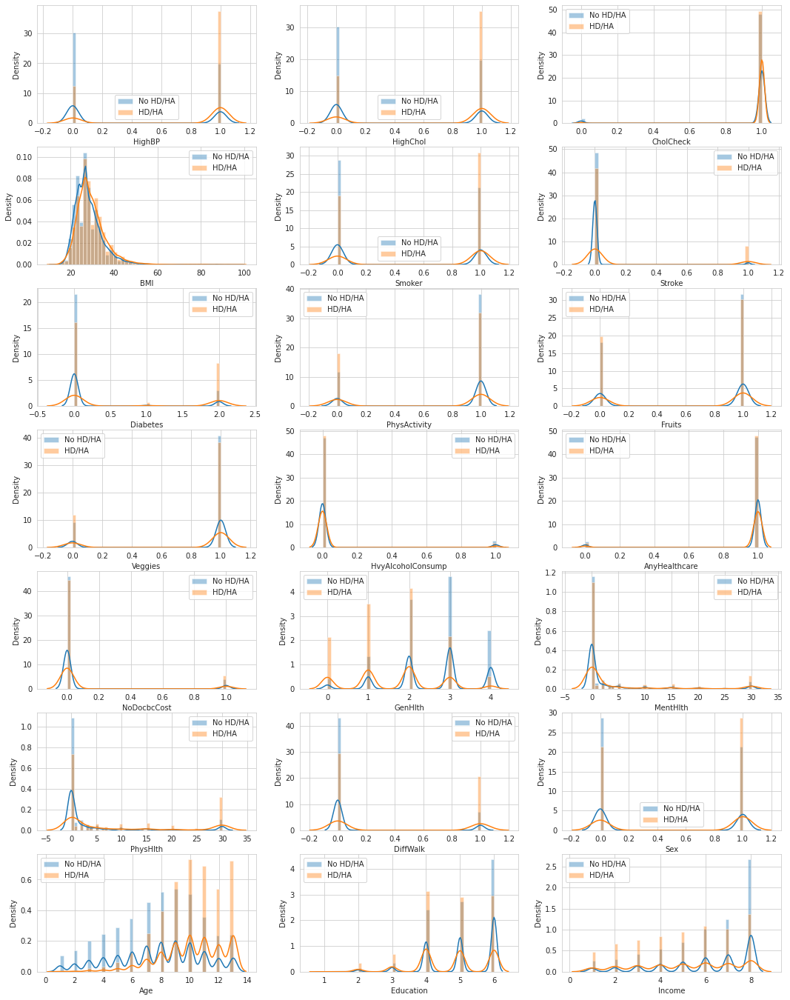

In [ ]:
features = heartdisease_df.drop('HeartDiseaseorAttack', axis=1).columns.values

no_hd = heartdisease_df.loc[heartdisease_df['HeartDiseaseorAttack'] == 0]
hd = heartdisease_df.loc[heartdisease_df['HeartDiseaseorAttack'] == 1]

sns.set_style('whitegrid')
plt.figure()
#fig, ax = plt.subplots(7,3,figsize=(28,16))
fig, ax = plt.subplots(7,3,figsize=(18,24))

for i, feat in enumerate(features):
    i += 1
    plt.subplot(7,3,i)
    #sns.kdeplot(no_hd[feat], bw=0.5,label="Class = 0")
    sns.distplot(no_hd[feat], bins=50, label="No HD/HA")
    #sns.kdeplot(hd[feat], bw=0.5,label="Class = 1")
    sns.distplot(hd[feat], bins=50, label="HD/HA")
    plt.xlabel(feat, fontsize=10)
    locs, labels = plt.xticks()
    plt.tick_params(axis='both', which='major', labelsize=10)
    plt.legend()
plt.show()

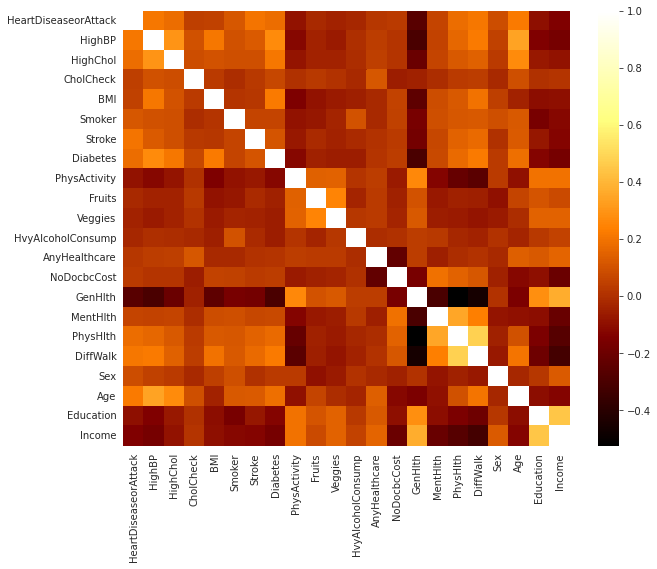

In [ ]:
correlations = heartdisease_df.corr()
pd.set_option("display.float", "{:.2f}".format)

plt.figure(figsize=(10,8))
sns.heatmap(data=correlations, cmap="afmhot")

plt.show()

In [ ]:
correlations['HeartDiseaseorAttack'].sort_values(ascending=False, key=abs)

HeartDiseaseorAttack    1.00
GenHlth                -0.26
Age                     0.22
DiffWalk                0.21
HighBP                  0.21
Stroke                  0.20
PhysHlth                0.18
HighChol                0.18
Diabetes                0.18
Income                 -0.14
Smoker                  0.11
Education              -0.10
PhysActivity           -0.09
Sex                     0.09
MentHlth                0.06
BMI                     0.05
CholCheck               0.04
Veggies                -0.04
NoDocbcCost             0.03
HvyAlcoholConsump      -0.03
Fruits                 -0.02
AnyHealthcare           0.02
Name: HeartDiseaseorAttack, dtype: float64

# Data Preprocessing

Considering whether to scale 'BMI', 'MentHlth' and 'PhysHlth' columns + splitting dataset

To reduce scope of project, no feature selection except for removing BMI - appears to have low correlation with heart disease, and usage of BMI as proxy for physical health is dubious and appropriate ordinal encoding for obsesity levels is difficult (i.e., using BMI as proxy for evaluating degree of obesity is highly dependent on other factors such as body fat percentage, bone density, ethinicitiy, etc.).

Use Minmax scaling - best way to scale data and not risk data leakage (don't want to standardize, since features are generally not normally distributed.)

Scaling - data leakage? Maybe not an issue (particularly for Minmax scaling), since domain knowledge gives us the range of values which should not change for this dataset (given that data is ordinal/binary)

… leakage means that information is revealed to the model that gives it an unrealistic advantage to make better predictions. This could happen when test data is leaked into the training set, or when data from the future is leaked to the past. Any time that a model is given information that it shouldn’t have access to when it is making predictions in real time in production, there is leakage.

— Page 93, Feature Engineering for Machine Learning, 2018.

In [ ]:
## Convert BMI to health risk classification
bmi_bins = [-np.inf,18.5, 25, 30, 35, 40, np.inf]
bmi_labels = [float(x) for x in list(range(6))]
heartdisease_df['BMICat'] = pd.to_numeric(pd.cut(heartdisease_df['BMI'], bins=bmi_bins, labels=bmi_labels))

#print(bmi_labels)
heartdisease_df.describe()

,HeartDiseaseorAttack,HighBP,HighChol,CholCheck,BMI,Smoker,Stroke,Diabetes,PhysActivity,Fruits,Veggies,HvyAlcoholConsump,AnyHealthcare,NoDocbcCost,GenHlth,MentHlth,PhysHlth,DiffWalk,Sex,Age,Education,Income,BMICat
count,253680.00,253680.00,253680.00,253680.00,253680.00,253680.00,253680.00,253680.00,253680.00,253680.00,253680.00,253680.00,253680.00,253680.00,253680.00,253680.00,253680.00,253680.00,253680.00,253680.00,253680.00,253680.00,253680.00
mean,0.09,0.43,0.42,0.96,28.38,0.44,0.04,0.30,0.76,0.63,0.81,0.06,0.95,0.08,2.49,3.18,4.24,0.17,0.44,8.03,5.05,6.05,2.08
std,0.29,0.49,0.49,0.19,6.61,0.50,0.20,0.70,0.43,0.48,0.39,0.23,0.22,0.28,1.07,7.41,8.72,0.37,0.50,3.05,0.99,2.07,1.11
min,0.00,0.00,0.00,0.00,12.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,1.00,1.00,0.00
25%,0.00,0.00,0.00,1.00,24.00,0.00,0.00,0.00,1.00,0.00,1.00,0.00,1.00,0.00,2.00,0.00,0.00,0.00,0.00,6.00,4.00,5.00,1.00
50%,0.00,0.00,0.00,1.00,27.00,0.00,0.00,0.00,1.00,1.00,1.00,0.00,1.00,0.00,3.00,0.00,0.00,0.00,0.00,8.00,5.00,7.00,2.00
75%,0.00,1.00,1.00,1.00,31.00,1.00,0.00,0.00,1.00,1.00,1.00,0.00,1.00,0.00,3.00,2.00,3.00,0.00,1.00,10.00,6.00,8.00,3.00
max,1.00,1.00,1.00,1.00,98.00,1.00,1.00,2.00,1.00,1.00,1.00,1.00,1.00,1.00,4.00,30.00,30.00,1.00,1.00,13.00,6.00,8.00,5.00


Text(0.5, 1.0, 'BMI Health Category Counts')

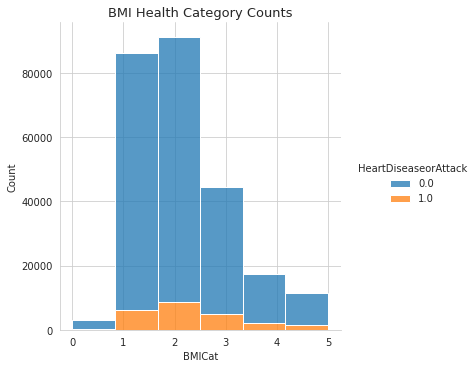

In [ ]:
sns.displot(x = "BMICat", data=heartdisease_df, bins=6, hue="HeartDiseaseorAttack", multiple="stack")
plt.title('BMI Health Category Counts', fontsize=13)

In [ ]:
## Minmax scaling - OK to do before since value ranges for features are already known, so shouldn't have data leakage

## Remove BMI and split targets from dataset
base_X = heartdisease_df.drop(['HeartDiseaseorAttack' , 'BMI'], axis=1)
#base_X = heartdisease_df.drop(['HeartDiseaseorAttack'], axis=1)
base_y = heartdisease_df['HeartDiseaseorAttack']

X_col_names = list(base_X.columns)
minmax_scaler = MinMaxScaler()

minmax_scaler.fit(base_X)

#base_X = pd.DataFrame(scaler.fit_transform(base_X))
#base_X.columns = X_col_names

base_X.describe()

,HighBP,HighChol,CholCheck,Smoker,Stroke,Diabetes,PhysActivity,Fruits,Veggies,HvyAlcoholConsump,AnyHealthcare,NoDocbcCost,GenHlth,MentHlth,PhysHlth,DiffWalk,Sex,Age,Education,Income,BMICat
count,253680.00,253680.00,253680.00,253680.00,253680.00,253680.00,253680.00,253680.00,253680.00,253680.00,253680.00,253680.00,253680.00,253680.00,253680.00,253680.00,253680.00,253680.00,253680.00,253680.00,253680.00
mean,0.43,0.42,0.96,0.44,0.04,0.30,0.76,0.63,0.81,0.06,0.95,0.08,2.49,3.18,4.24,0.17,0.44,8.03,5.05,6.05,2.08
std,0.49,0.49,0.19,0.50,0.20,0.70,0.43,0.48,0.39,0.23,0.22,0.28,1.07,7.41,8.72,0.37,0.50,3.05,0.99,2.07,1.11
min,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,1.00,1.00,0.00
25%,0.00,0.00,1.00,0.00,0.00,0.00,1.00,0.00,1.00,0.00,1.00,0.00,2.00,0.00,0.00,0.00,0.00,6.00,4.00,5.00,1.00
50%,0.00,0.00,1.00,0.00,0.00,0.00,1.00,1.00,1.00,0.00,1.00,0.00,3.00,0.00,0.00,0.00,0.00,8.00,5.00,7.00,2.00
75%,1.00,1.00,1.00,1.00,0.00,0.00,1.00,1.00,1.00,0.00,1.00,0.00,3.00,2.00,3.00,0.00,1.00,10.00,6.00,8.00,3.00
max,1.00,1.00,1.00,1.00,1.00,2.00,1.00,1.00,1.00,1.00,1.00,1.00,4.00,30.00,30.00,1.00,1.00,13.00,6.00,8.00,5.00


In [ ]:
## Do train-test split

sss = StratifiedShuffleSplit(n_splits=5, test_size=0.2, random_state=42)

## Check training and test distributions after split
for train_index, test_index in sss.split(base_X, base_y):
    print("Train index:", train_index, "Test index:", test_index)
    base_X_train, base_X_test = base_X.iloc[train_index], base_X.iloc[test_index]
    base_y_train, base_y_test = base_y.iloc[train_index], base_y.iloc[test_index]

# Turn into an array
base_X_train = base_X_train.values
base_X_test = base_X_test.values
base_y_train = base_y_train.values
base_y_test = base_y_test.values

# See if both the train and test label distribution are similarly distributed
train_unique_label, train_counts_label = np.unique(base_y_train, return_counts=True)
test_unique_label, test_counts_label = np.unique(base_y_test, return_counts=True)
print('-' * 100)

print('Label Distributions: \n')
print(train_counts_label/ len(base_y_train))
print(test_counts_label/ len(base_y_test))

Train index: [ 87895 182101  32491 ...  80730 224887 107782] Test index: [198911  30665  74347 ... 187668 210997  34125]
Train index: [ 37759 146902 117739 ...  72109  26694  92098] Test index: [172102  30675 146804 ...  85512  93128  64688]
Train index: [234050  68062  85634 ... 139048 228149 252739] Test index: [215947 112878  80621 ...  69266 137724  92076]
Train index: [155745   1274 153086 ... 164757 224523  21621] Test index: [ 39318 162313 101266 ...  28309   4755 151237]
Train index: [186603 158195 215223 ...  71484  23215  39876] Test index: [ 81768 132312 137274 ...  65431 223574 170716]
----------------------------------------------------------------------------------------------------
Label Distributions: 

[0.90581638 0.09418362]
[0.90580653 0.09419347]


In [ ]:
print('Length of X (train): {} | Length of y (train): {}'.format(len(base_X_train), len(base_y_train)))
print('Length of X (test): {} | Length of y (test): {}'.format(len(base_X_test), len(base_y_test)))

Length of X (train): 202944 | Length of y (train): 202944
Length of X (test): 50736 | Length of y (test): 50736


# Training

SVM has performance issues with larger datasets - better to try LinearSVC or SGDClassifier with hinge loss (equivalent to Linear SVM).


DT:
*   No subsampling: max_depth=14, min_samples_leaf=10, min_samples_split=5) - f1 = 0.211
*   SMOTE: List item
*   Cost-sensitive: List item

RF:
*   No subsampling: max_depth=12, min_samples_leaf=10, min_samples_split=20, n_estimators=10
*   SMOTE: max_depth=14, min_samples_leaf=5, min_samples_split=20, n_estimators=20 - f1 = 0.407
*   Cost-sensitive: List item

LR:
*   No subsampling: C=8.335076827628296, solver='liblinear' / C=14.542411101988284, solver='newton-cg'
*   SMOTE: C=0.0052080787257212735, solver='lbfgs'
*   Cost-sensitive: List item

NN:
*   No subsampling:
*   SMOTE: List item
*   Cost-sensitive: List item

BC:
*   No subsampling:
*   SMOTE: List item
*   Cost-sensitive: List item

LinSVC:
*   No subsampling:
*   SMOTE: List item
*   Cost-sensitive: List item

In [ ]:
def get_new_models():
  models = {
      'LogReg': LogisticRegression(),
      #'SVC': SVC(),
      #'LinSVC': LinearSVC(),
      #'NB': GaussianNB(),
      #'NB': CategoricalNB(),
      #'DT': DecisionTreeClassifier(),
      #'RF': RandomForestClassifier(),
      #'NN': MLPClassifier(),
      #'BC': BaggingClassifier(),
      #'SGD_LinSVC': SGDClassifier(),
      #'SGD_LinSVC_cost': SGDClassifier()
  }


  model_params = {
      'LogReg': {'cf__penalty': ['l2'], 'cf__solver': ['newton-cg', 'lbfgs', 'liblinear'], 'cf__C': loguniform(1e-3, 1e4)},
      'KNN': {'cf__n_neighbors': list(range(1,20)), 'cf__algorithm': ['auto', 'ball_tree', 'kd_tree', 'brute']},
      #'SVC': {'C': [0.5, 0.7, 0.9, 1], 'kernel': ['rbf', 'poly', 'sigmoid', 'linear']},
      #, 'class_weight'= [{0:1.0, 1:570}
      #'LinSVC': {'cf__C': [0.5, 0.7, 0.9, 1]},
      'LinSVC': {},
      'NB': {},
      'DT': {'cf__max_depth': list(range(5,15)), 'cf__min_samples_split': [2, 5, 10, 20, 50], 'cf__min_samples_leaf': [1, 3, 5, 10, 20, 50]},
      'RF': {'cf__max_depth': list(range(5,15)), 'cf__n_estimators': [10, 20, 50, 100], 'cf__min_samples_split': [2, 5, 10, 20, 50], 'cf__min_samples_leaf': [1, 3, 5, 10, 20, 50]},
      'NN': {'cf__activation' : ['logistic', 'tanh', 'relu'], 'cf__solver' : ['lbfgs', 'sgd', 'adam'], \
             'cf__hidden_layer_sizes': [(20,10), (30), (20,20)], 'cf__alpha' : 10.0 ** -np.arange(1, 7)},
      'BC': {'cf__n_estimators' : [10, 20, 30, 40, 50], "cf__bootstrap": [True], "cf__oob_score": [True], 'cf__base_estimator__max_depth': list(range(5,15)), \
             'cf__base_estimator__min_samples_split' : [2, 5, 10, 20, 50], 'cf__base_estimator__min_samples_leaf': [1, 3, 5, 10, 20, 50]},
      'SGD_LinSVC': {'cf__base_estimator__loss': ['hinge'], 'cf__base_estimator__max_iter': list(range(5,10)), 'cf__base_estimator__alpha': 10.0**-np.arange(1,7)},
      'SGD_LinSVC_cost': {'cf__loss': ['hinge'], 'cf__max_iter': list(range(5,10)), 'cf__alpha': 10.0**-np.arange(1,7)},
  }

  return models, model_params



def print_scores(y_test, y_pred, y_pred_prob):
  print('test-set confusion matrix:\n', confusion_matrix(y_test,y_pred))
  print('recall score: ', recall_score(y_test,y_pred))
  print('precision score: ', precision_score(y_test,y_pred))
  print('f1 score: ', f1_score(y_test,y_pred))
  print('accuracy score: ', accuracy_score(y_test,y_pred))
  print('ROC AUC: {}'.format(roc_auc_score(y_test, y_pred_prob[:,1])))



def train_models(models, model_params, X_train, y_train, sampling='None', scaler=MinMaxScaler()):

  trained_models = []

  skfold = StratifiedKFold(n_splits=5, random_state=None, shuffle=True)

  #MCC_scoring = make_scorer(matthews_corrcoef)
  f1_scoring = make_scorer(f1_score)

  for model_name in models:

    model_class = models[model_name].__class__
    #print(model_class.__name__)
    print('\nCross-validation with sampling: {}, for {}'.format(sampling, model_class.__name__))

    ## Number of iterations for Randomized Search
    if model_name in ['LogReg', 'DT', 'SGD_LinSVC', 'SGD_LinSVC_cost']:
      n_search_iter = 20
    elif model_name in ['RF']:
      n_search_iter = 10
    else:
      n_search_iter = 3

    ## Setup pipeline based on imbalanced learning strategy
    if sampling == 'SMOTE':
      print('Oversampling with SMOTE')

      pipeline = Pipeline([('scaler',scaler), ('sampl',SMOTE(sampling_strategy='minority')), ('cf', model_class())])
      #pipeline = Pipeline([('sampl',SMOTE(sampling_strategy='minority')), ('cf', model_class())])

      if model_name == 'BC':
        pipeline = Pipeline([('scaler',scaler), ('sampl',SMOTE(sampling_strategy='minority')), ('cf', model_class(DecisionTreeClassifier()))])
      elif model_name == 'SGD_LinSVC':
        pipeline = Pipeline([('scaler',scaler), ('sampl',SMOTE(sampling_strategy='minority')), ('cf', CalibratedClassifierCV(SGDClassifier(), cv=skfold))])

    elif sampling == 'Cost':
      print('Cost-sensitive')

      #pipeline = Pipeline([('scaler',scaler), ('cf', model_class(class_weight='balanced'))])

      if model_name == 'BC':
        pipeline = Pipeline([('scaler',scaler), ('cf', model_class(DecisionTreeClassifier(class_weight='balanced')))])
      elif model_name == 'SGD_LinSVC':
        pipeline = Pipeline([('scaler',scaler), ('cf',  CalibratedClassifierCV(SGDClassifier(class_weight='balanced'), cv=skfold))])
      else:
        pipeline = Pipeline([('scaler',scaler), ('cf', model_class(class_weight='balanced'))])
      #pipeline = imb_make_pipeline(model_class(class_weight='balanced'))
    elif sampling == 'NearMiss':
      print('Undersampling with NearMiss')

      pipeline = Pipeline([('scaler',scaler), ('sampl',NearMiss(sampling_strategy='majority')), ('cf', model_class())])
      #pipeline = imb_make_pipeline(NearMiss(sampling_strategy='majority'),  model_class())
    elif sampling == 'Combined':
      print('Combine subsampling with SMOTE and TomekLinks')

      pipeline = Pipeline([('scaler',scaler), ('sampl', SMOTETomek(tomek=TomekLinks(sampling_strategy='majority'))), ('cf', model_class())])
      #pipeline = imb_make_pipeline(SMOTETomek(tomek=TomekLinks(sampling_strategy='majority')),  model_class())
    else:
      print('No subsampling')

      pipeline = Pipeline([('scaler',scaler), ('cf', model_class())])

      if model_name == 'BC':
        pipeline = Pipeline([('scaler',scaler), ('cf', model_class(DecisionTreeClassifier()))])
      elif model_name == 'SGD_LinSVC':
        pipeline = Pipeline([('scaler',scaler), ('cf', CalibratedClassifierCV(SGDClassifier(), cv=skfold))])
      #pipeline = imb_make_pipeline(model_class())


    ## Randomized Search CV
    rand_search_cv = RandomizedSearchCV(pipeline, model_params[model_name], \
                                    n_jobs = 3, n_iter=n_search_iter, scoring=f1_scoring, \
                                    cv = skfold, return_train_score=True, verbose=1)

    ## Start training
    start_time = time.time()

    rand_search_cv.fit(X_train, y_train)
    cv_score = cross_val_score(rand_search_cv, X_train, y_train, scoring=f1_scoring, cv=skfold)

    train_time = time.time() - start_time
    hours, rem = divmod(train_time, 3600)
    minutes, seconds = divmod(rem, 60)
    print('Training took {} hour(s) {} minute(s) {} second(s)\n'.format(int(hours), int(minutes), int(seconds)))

    ## Get best model and print metrics
    best_model = rand_search_cv.best_estimator_

    #if sampling == 'Cost' and model_name == 'SGD_LinSVC_cost':
      ## Should actually split data into training and calibration sets
    #  calibrator = CalibratedClassifierCV(best_model, cv='prefit')
    #  best_model = calibrator.fit(X_train, y_train)

    trained_models.append(best_model)

    print(best_model)
    print('')
    print("Parameters: {}".format(rand_search_cv.best_params_))
    print("Score (f1): {}".format(rand_search_cv.best_score_))
    print("Cross-validation results: {}".format(rand_search_cv.cv_results_))
    print('---' * 45)

  return trained_models


def test_models(trained_models, X_test=base_X_test, y_test=base_y_test):
  labels = ['No_HD_HA', 'HD_HA']

  fig, ax = plt.subplots(len(trained_models), 1, figsize=(7,len(trained_models)*3*3), squeeze=False)

  for i, model in enumerate(trained_models):
    print('Test results for model: ', model)

    model_prediction = model.predict(X_test)
    print(classification_report(y_test, model_prediction, target_names=labels))

    #y_score = model.decision_function(X_test)

    #average_precision = average_precision_score(y_test, y_score)

    #print('Average precision-recall score: {0:0.2f}'.format(average_precision))


    print("accuracy: {}".format(model.score(X_test, y_test)))
    print("precision: {}".format(precision_score(y_test, model_prediction)))
    print("recall: {}".format(recall_score(y_test, model_prediction)))
    print("f1: {}".format(f1_score(y_test, model_prediction)))
    print('ROC AUC: {}'.format(roc_auc_score(y_test, model_prediction)))
    print('MCC: {}'.format(matthews_corrcoef(y_test, model_prediction)))

    precision, recall, _ = precision_recall_curve(y_test, model_prediction)
    print('PR AUC: {}'.format(auc(recall, precision)))


    tick_marks = np.arange(len(labels))

    #plt.figure(figsize=(5,5))
    #plt.subplot(len(trained_models),1,i)

    conf_mat = confusion_matrix(y_test, model_prediction)
    sns.heatmap(conf_mat, ax=ax[i][0], annot=True, cmap=plt.cm.Reds, fmt='d')
    ax[i, 0].set_title("{} \n Confusion Matrix".format(model.__class__.__name__), fontsize=14)
    ax[i, 0].set_xticklabels(labels, fontsize=14, rotation=45)
    ax[i, 0].set_yticklabels(labels, fontsize=14, rotation=360)
    ax[i, 0].set_ylabel('Actual Class')
    ax[i, 0].set_xlabel('Predicted Class')

    ## Save plot?
    #plt.ylabel('Actual Class')
    #plt.xlabel('Predicted Class')

    print('---' * 45)

  plt.show()

## Without any subsampling

In [ ]:
models, model_params = get_new_models()
trained_normal_models = train_models(models, model_params, base_X_train, base_y_train, scaler=minmax_scaler)



Cross-validation with sampling: None, for LogisticRegression
No subsampling
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Training took 0 hour(s) 10 minute(s) 40 second(s)

Pipeline(steps=[('scaler', MinMaxScaler()),
                ('cf', LogisticRegression(C=5.2422717489696256))])

Parameters: {'cf__C': 5.2422717489696256, 'cf__penalty': 'l2', 'cf__solver': 'lbfgs'}
Score (f1): 0.20543091296094845
Cross-validation results: {'mean_fit_time': array([8.56562061, 3.37519937, 6.4323101 , 6.47898755, 6.20620737,
       5.53462062, 2.402494  , 6.26361294, 2.53090577, 2.43254366,
       6.63887486, 2.54784832, 2.81837573, 2.42263918, 2.7475801 ,
       2.62075963, 2.8279

Test results for model:  Pipeline(steps=[('scaler', MinMaxScaler()),
                ('cf', LogisticRegression(C=5.2422717489696256))])
              precision    recall  f1-score   support

    No_HD_HA       0.92      0.99      0.95     45957
       HD_HA       0.55      0.12      0.20      4779

    accuracy                           0.91     50736
   macro avg       0.73      0.56      0.58     50736
weighted avg       0.88      0.91      0.88     50736

accuracy: 0.9079943235572374
precision: 0.5517241379310345
recall: 0.12387528771709563
f1: 0.202323991797676
ROC AUC: 0.5567044911288221
MCC: 0.23023718543396693
PR AUC: 0.3790623271413151
---------------------------------------------------------------------------------------------------------------------------------------


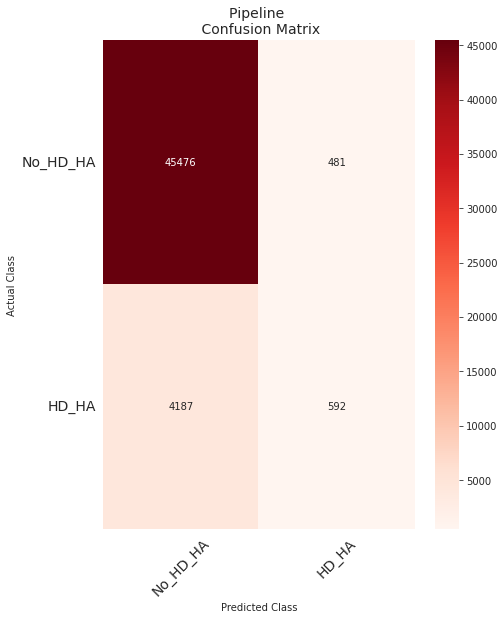

In [ ]:
test_models(trained_normal_models)

## Oversampling with SMOTE

In [ ]:
models, model_params = get_new_models()
trained_oversampling_models = train_models(models, model_params, base_X_train, base_y_train, sampling='SMOTE', scaler=minmax_scaler)


Cross-validation with sampling: SMOTE, for LogisticRegression
Oversampling with SMOTE
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Training took 0 hour(s) 42 minute(s) 31 second(s)

Pipeline(steps=[('scaler', MinMaxScaler()),
                ('sampl', SMOTE(sampling_strategy='minority')),
                ('cf',
                 LogisticRegression(C=0.017132033799832528,
                                    solver='newton-cg'))])

Parameters: {'cf__C': 0.017132033799832528, 'cf__penalty': 'l2', 'cf__solver': 'newton-cg'}
Score (f1): 0.3762245237542086
Cross-validation results: {'mean_fit_time': array([21.11391115, 19.40782123, 13.36444221, 13.95886989, 13.22476473,


Test results for model:  Pipeline(steps=[('scaler', MinMaxScaler()),
                ('sampl', SMOTE(sampling_strategy='minority')),
                ('cf',
                 LogisticRegression(C=0.017132033799832528,
                                    solver='newton-cg'))])
              precision    recall  f1-score   support

    No_HD_HA       0.97      0.75      0.85     45957
       HD_HA       0.25      0.79      0.37      4779

    accuracy                           0.75     50736
   macro avg       0.61      0.77      0.61     50736
weighted avg       0.90      0.75      0.80     50736

accuracy: 0.7532915484074425
precision: 0.24622851895579168
recall: 0.7855199832600962
f1: 0.3749313358302122
ROC AUC: 0.7677300723576849
MCC: 0.3411462049285921
PR AUC: 0.5259755598433586
---------------------------------------------------------------------------------------------------------------------------------------


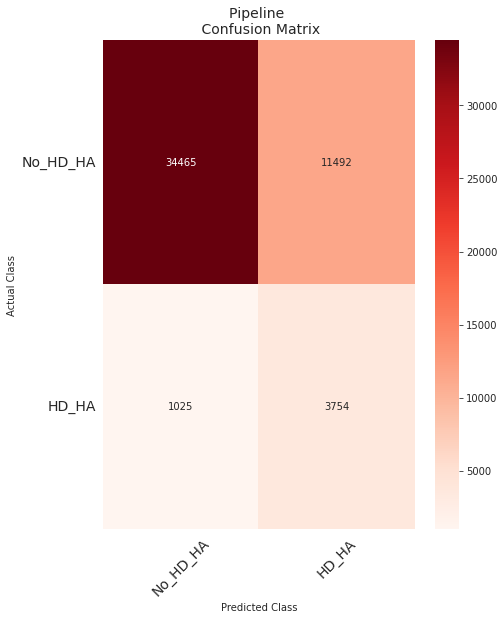

In [ ]:
test_models(trained_oversampling_models)

## LogReg, SVC (maybe) and RF with class weights

In [ ]:
weighted_models = {
    #'LogReg': LogisticRegression(class_weight='balanced'),
    #'SVC': SVC(class_weight='balanced'),
    #'LinSVC': LinearSVC(class_weight='balanced'),
    #'RF': RandomForestClassifier(class_weight='balanced'),
    #'DT': DecisionTreeClassifier(class_weight='balanced'),
    #'BC': BaggingClassifier(),
    #'SGD_LinSVC_cost': SGDClassifier(),
    'SGD_LinSVC': SGDClassifier()
}

_, model_params = get_new_models()

trained_cost_sens_models = train_models(weighted_models, model_params, base_X_train, base_y_train, sampling='Cost', scaler=minmax_scaler)




Cross-validation with sampling: Cost, for SGDClassifier
Cost-sensitive
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Training took 0 hour(s) 13 minute(s) 1 second(s)

Pipeline(steps=[('scaler', MinMaxScaler()),
                ('cf',
                 CalibratedClassifierCV(base_estimator=SGDClassifier(alpha=0.001,
                                                                     class_weight='balanced',
                                                                     max_iter=9),
                                        cv=StratifiedKFold(n_splits=5, random_state=None, shuffle=True)))])

Parameters: {'cf__base_estimator__max_iter': 9, 'cf__base_estimator__los

Test results for model:  Pipeline(steps=[('scaler', MinMaxScaler()),
                ('cf',
                 CalibratedClassifierCV(base_estimator=SGDClassifier(alpha=0.001,
                                                                     class_weight='balanced',
                                                                     max_iter=9),
                                        cv=StratifiedKFold(n_splits=5, random_state=None, shuffle=True)))])
              precision    recall  f1-score   support

    No_HD_HA       0.92      0.99      0.95     45957
       HD_HA       0.56      0.12      0.20      4779

    accuracy                           0.91     50736
   macro avg       0.74      0.56      0.58     50736
weighted avg       0.88      0.91      0.88     50736

accuracy: 0.90819142226427
precision: 0.5570216776625825
recall: 0.12366603892027621
f1: 0.20239726027397262
ROC AUC: 0.5567195438198657
MCC: 0.23156901364496693
PR AUC: 0.3816163275440311
--------------------------

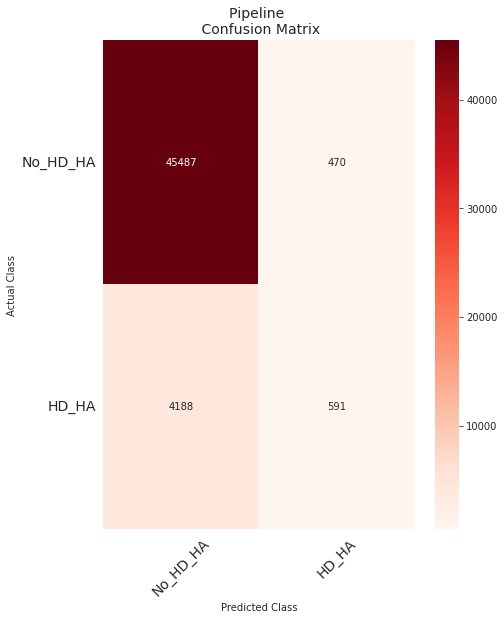

In [ ]:
test_models(trained_cost_sens_models)

# Explaining models with LIME and DiCE

### Set-up LIME

In [ ]:
## Setup for LIME

#cat_feat_indexes = list(range(len(X_col_names)))
cat_feat_indexes = [i for i, col in enumerate(X_col_names) if col not in ['MentHlth', 'PhysHlth']]

lime_explainer = LimeTabularExplainer(base_X_train, mode='classification', feature_names=X_col_names, class_names=['No HD/HA', 'HD/HA'], \
                                 categorical_features=cat_feat_indexes, verbose=True)


In [ ]:
def get_lime_expl(class_model, explainer, X_test, y_test, n_explanations = 5):
  print("Getting LIME explanations")
  print(class_model)

  predictions = class_model.predict(X_test)
  print('Sample predictions: ', predictions[:10])
  print('Sample actual labels: ', y_test[:10])

  for i in range(n_explanations):
    print('\nExplanation for test instance at index ', i)
    print('Actual label: ', y_test[i])
    exp = explainer.explain_instance(X_test[i],
        class_model.predict_proba, num_features=10)
    exp.as_pyplot_figure();

    exp.show_in_notebook(show_table=True, show_all=True)
  print('---' * 45)

### Set-up DiCE

In [ ]:
## Setup for DiCE

dice_data = dice_ml.Data(dataframe=heartdisease_df.drop(['BMI'], axis=1), \
                         continuous_features=['MentHlth', 'PhysHlth'], outcome_name='HeartDiseaseorAttack')

# dice_data = dice_ml.Data(dataframe=heartdisease_df, \
#                          continuous_features=['BMI', 'MentHlth', 'PhysHlth'], outcome_name='HeartDiseaseorAttack')

In [ ]:
def get_dice_expl(class_model, d_data, X_test, y_test, n_explanations = 5):
  print("Getting DiCE explanations")
  print(class_model)

  predictions = class_model.predict(X_test)
  print('Sample predictions: ', predictions[:10])
  print('Sample actual labels: ', y_test[:10])

  ## List of features to vary - limit to immediately actionable features
  non_actionable = ['Stroke', 'Diabetes', 'Sex', 'Age']
  non_actionable_strict = ['Stroke', 'Diabetes', 'Sex', 'Age', 'Smoker', 'HighBP', 'HighChol']
  possibly_actionable = ['CholCheck', 'AnyHealthcare', 'NoDocbcCost', 'GenHlth', 'MentHlth', \
                          'PhysHlth', 'DiffWalk', 'Education', 'Income']

  #feats_vary = [feat for feat in X_col_names if feat not in non_actionable]
  feats_vary = [feat for feat in X_col_names if feat not in non_actionable and feat not in possibly_actionable]

  #feats_vary = [feat for feat in X_col_names if feat not in non_actionable_strict]
  #feats_vary = [feat for feat in X_col_names if feat not in non_actionable_strict and feat not in possibly_actionable]

  dice_model = dice_ml.Model(model=class_model, backend="sklearn")

  explainer = dice_ml.Dice(d_data, dice_model, method="random")

  # Put X_test into pandas dataframe
  X_test_df = pd.DataFrame(X_test)
  X_test_df.columns = X_col_names

  for i in range(n_explanations):
    print('\nExplanation for test instance at index ', i)
    print('Actual label: ', y_test[i])
    exp = explainer.generate_counterfactuals(X_test_df[i:i+1], total_CFs=3, desired_class='opposite', \
                                             features_to_vary=feats_vary)
    exp.visualize_as_dataframe(show_only_changes=True)

    print('---' * 45)
  ## Global feature importances
  test_subset = X_test_df[:100]
  #test_subset = X_test_df
  imp = explainer.global_feature_importance(test_subset)
  print('\nGlobal feature importance: ', imp.summary_importance)

  print('---' * 45)

### Get explanations

In [ ]:
## Models with no subsampling

for model in trained_normal_models:
  get_lime_expl(model, lime_explainer, base_X_test, base_y_test)
  get_dice_expl(model, dice_data, base_X_test, base_y_test)


Getting LIME explanations
Pipeline(steps=[('scaler', MinMaxScaler()),
                ('sampl', SMOTE(sampling_strategy='minority')),
                ('cf',
                 LogisticRegression(C=0.017132033799832528,
                                    solver='newton-cg'))])
Sample predictions:  [1. 0. 1. 1. 0. 0. 1. 0. 0. 0.]
Sample actual labels:  [0. 0. 1. 0. 1. 0. 1. 0. 0. 0.]

Explanation for test instance at index  0
Actual label:  0.0
Intercept 0.2598422534019537
Prediction_local [0.62866017]
Right: 0.6904550280546502



Explanation for test instance at index  1
Actual label:  0.0
Intercept 0.3836085000588431
Prediction_local [0.26137969]
Right: 0.20192803733790782



Explanation for test instance at index  2
Actual label:  1.0
Intercept 0.43047428508671975
Prediction_local [0.57153422]
Right: 0.5704314786261746



Explanation for test instance at index  3
Actual label:  0.0
Intercept 0.4454434026173777
Prediction_local [0.45787287]
Right: 0.5475061472941383



Explanation for test instance at index  4
Actual label:  1.0
Intercept 0.334669849952226
Prediction_local [0.36208819]
Right: 0.45845698841430416


---------------------------------------------------------------------------------------------------------------------------------------
Getting DiCE explanations
Pipeline(steps=[('scaler', MinMaxScaler()),
                ('sampl', SMOTE(sampling_strategy='minority')),
                ('cf',
                 LogisticRegression(C=0.017132033799832528,
                                    solver='newton-cg'))])
Sample predictions:  [1. 0. 1. 1. 0. 0. 1. 0. 0. 0.]
Sample actual labels:  [0. 0. 1. 0. 1. 0. 1. 0. 0. 0.]

Explanation for test instance at index  0
Actual label:  0.0


100%|██████████| 1/1 [00:00<00:00,  2.18it/s]

Query instance (original outcome : 1)


,HighBP,HighChol,CholCheck,Smoker,Stroke,Diabetes,PhysActivity,Fruits,Veggies,HvyAlcoholConsump,AnyHealthcare,NoDocbcCost,GenHlth,MentHlth,PhysHlth,DiffWalk,Sex,Age,Education,Income,BMICat,HeartDiseaseorAttack
0,1.00,1.00,0.00,0.00,1.00,0.00,0.00,1.00,1.00,0.00,1.00,1.00,0.00,15.00,29.00,1.00,0.00,7.00,4.00,4.00,5.00,1



Diverse Counterfactual set (new outcome: 0.0)


,HighBP,HighChol,CholCheck,Smoker,Stroke,Diabetes,PhysActivity,Fruits,Veggies,HvyAlcoholConsump,AnyHealthcare,NoDocbcCost,GenHlth,MentHlth,PhysHlth,DiffWalk,Sex,Age,Education,Income,BMICat,HeartDiseaseorAttack
0,0.0,0.0,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,0.0
1,0.0,-,-,-,-,-,-,-,-,1.0,-,-,-,-,-,-,-,-,-,-,-,0.0
2,-,0.0,-,-,-,-,-,-,-,1.0,-,-,-,-,-,-,-,-,-,-,-,0.0


---------------------------------------------------------------------------------------------------------------------------------------

Explanation for test instance at index  1
Actual label:  0.0


100%|██████████| 1/1 [00:00<00:00,  1.99it/s]

No Counterfactuals found for the given configuration, perhaps try with different parameters... ; total time taken: 00 min 00 sec
Query instance (original outcome : 0)


,HighBP,HighChol,CholCheck,Smoker,Stroke,Diabetes,PhysActivity,Fruits,Veggies,HvyAlcoholConsump,AnyHealthcare,NoDocbcCost,GenHlth,MentHlth,PhysHlth,DiffWalk,Sex,Age,Education,Income,BMICat,HeartDiseaseorAttack
0,0.00,0.00,1.00,1.00,0.00,0.00,1.00,1.00,1.00,0.00,1.00,0.00,2.00,0.00,1.00,0.00,1.00,6.00,4.00,8.00,4.00,0



No counterfactuals found!
---------------------------------------------------------------------------------------------------------------------------------------

Explanation for test instance at index  2
Actual label:  1.0


100%|██████████| 1/1 [00:00<00:00,  2.17it/s]

Query instance (original outcome : 1)


,HighBP,HighChol,CholCheck,Smoker,Stroke,Diabetes,PhysActivity,Fruits,Veggies,HvyAlcoholConsump,AnyHealthcare,NoDocbcCost,GenHlth,MentHlth,PhysHlth,DiffWalk,Sex,Age,Education,Income,BMICat,HeartDiseaseorAttack
0,1.00,0.00,1.00,0.00,0.00,0.00,1.00,1.00,1.00,0.00,1.00,0.00,2.00,0.00,0.00,0.00,0.00,13.00,4.00,5.00,2.00,1



Diverse Counterfactual set (new outcome: 0.0)


,HighBP,HighChol,CholCheck,Smoker,Stroke,Diabetes,PhysActivity,Fruits,Veggies,HvyAlcoholConsump,AnyHealthcare,NoDocbcCost,GenHlth,MentHlth,PhysHlth,DiffWalk,Sex,Age,Education,Income,BMICat,HeartDiseaseorAttack
0,0.0,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,4.0,0.0
1,0.0,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,0.0,0.0
2,-,-,-,-,-,-,-,-,-,1.0,-,-,-,-,-,-,-,-,-,-,5.0,0.0


---------------------------------------------------------------------------------------------------------------------------------------

Explanation for test instance at index  3
Actual label:  0.0


100%|██████████| 1/1 [00:00<00:00,  2.43it/s]

Query instance (original outcome : 1)


,HighBP,HighChol,CholCheck,Smoker,Stroke,Diabetes,PhysActivity,Fruits,Veggies,HvyAlcoholConsump,AnyHealthcare,NoDocbcCost,GenHlth,MentHlth,PhysHlth,DiffWalk,Sex,Age,Education,Income,BMICat,HeartDiseaseorAttack
0,0.00,1.00,1.00,0.00,0.00,2.00,1.00,0.00,1.00,0.00,1.00,0.00,2.00,0.00,0.00,0.00,0.00,11.00,5.00,3.00,1.00,1



Diverse Counterfactual set (new outcome: 0.0)


,HighBP,HighChol,CholCheck,Smoker,Stroke,Diabetes,PhysActivity,Fruits,Veggies,HvyAlcoholConsump,AnyHealthcare,NoDocbcCost,GenHlth,MentHlth,PhysHlth,DiffWalk,Sex,Age,Education,Income,BMICat,HeartDiseaseorAttack
0,-,-,-,-,-,-,-,-,-,1.0,-,-,-,-,-,-,-,-,-,-,4.0,0.0
1,-,0.0,-,-,-,-,0.0,-,-,-,-,-,-,-,-,-,-,-,-,-,-,0.0
2,-,-,-,-,-,-,-,1.0,-,1.0,-,-,-,-,-,-,-,-,-,-,-,0.0


---------------------------------------------------------------------------------------------------------------------------------------

Explanation for test instance at index  4
Actual label:  1.0


100%|██████████| 1/1 [00:00<00:00,  2.28it/s]

Query instance (original outcome : 0)


,HighBP,HighChol,CholCheck,Smoker,Stroke,Diabetes,PhysActivity,Fruits,Veggies,HvyAlcoholConsump,AnyHealthcare,NoDocbcCost,GenHlth,MentHlth,PhysHlth,DiffWalk,Sex,Age,Education,Income,BMICat,HeartDiseaseorAttack
0,1.00,1.00,1.00,0.00,0.00,2.00,1.00,0.00,1.00,0.00,0.00,1.00,2.00,0.00,0.00,1.00,0.00,7.00,4.00,6.00,3.00,0



Diverse Counterfactual set (new outcome: 1.0)


,HighBP,HighChol,CholCheck,Smoker,Stroke,Diabetes,PhysActivity,Fruits,Veggies,HvyAlcoholConsump,AnyHealthcare,NoDocbcCost,GenHlth,MentHlth,PhysHlth,DiffWalk,Sex,Age,Education,Income,BMICat,HeartDiseaseorAttack
0,-,-,-,1.0,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,4.0,1.0
1,-,-,-,1.0,-,-,-,1.0,-,-,-,-,-,-,-,-,-,-,-,-,-,1.0
2,-,-,-,1.0,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,0.0,1.0


---------------------------------------------------------------------------------------------------------------------------------------


100%|██████████| 100/100 [00:41<00:00,  2.39it/s]



Global feature importance:  {'Age': 0.51, 'GenHlth': 0.366, 'Stroke': 0.156, 'PhysHlth': 0.092, 'Income': 0.091, 'Sex': 0.09, 'Diabetes': 0.087, 'HighChol': 0.081, 'MentHlth': 0.081, 'BMICat': 0.08, 'Education': 0.073, 'Smoker': 0.068, 'HighBP': 0.064, 'CholCheck': 0.047, 'NoDocbcCost': 0.045, 'DiffWalk': 0.043, 'HvyAlcoholConsump': 0.041, 'Fruits': 0.039, 'Veggies': 0.03, 'AnyHealthcare': 0.029, 'PhysActivity': 0.027}
---------------------------------------------------------------------------------------------------------------------------------------


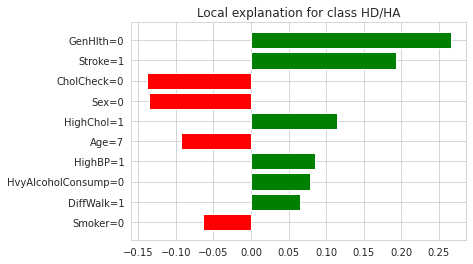

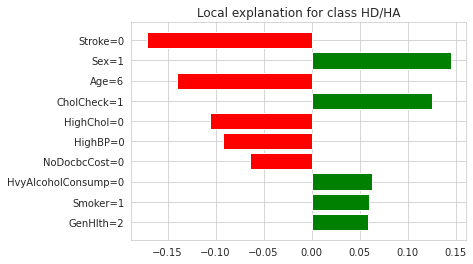

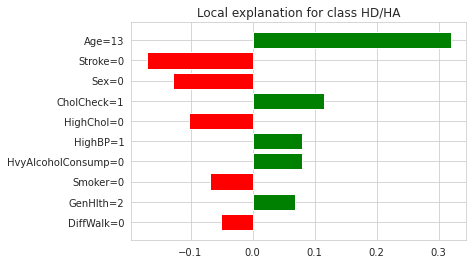

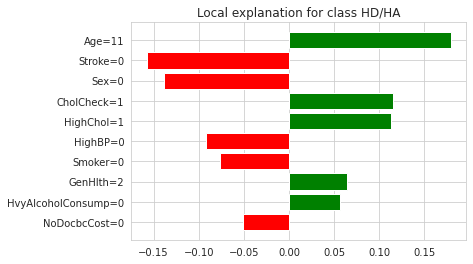

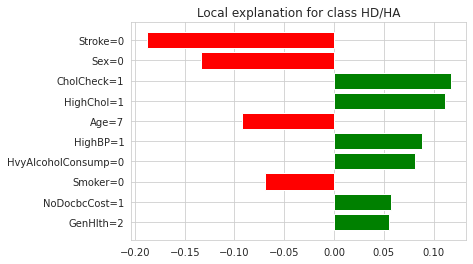

In [ ]:
## Models with SMOTE

for model in trained_oversampling_models:
  get_lime_expl(model, lime_explainer, base_X_test, base_y_test)
  get_dice_expl(model, dice_data, base_X_test, base_y_test)


Getting LIME explanations
Pipeline(steps=[('scaler', MinMaxScaler()),
                ('cf',
                 CalibratedClassifierCV(base_estimator=SGDClassifier(alpha=0.001,
                                                                     class_weight='balanced',
                                                                     max_iter=9),
                                        cv=StratifiedKFold(n_splits=5, random_state=None, shuffle=True)))])
Sample predictions:  [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
Sample actual labels:  [0. 0. 1. 0. 1. 0. 1. 0. 0. 0.]

Explanation for test instance at index  0
Actual label:  0.0
Intercept 0.08167444771138503
Prediction_local [0.21252715]
Right: 0.2811643533626951



Explanation for test instance at index  1
Actual label:  0.0
Intercept 0.15363350348733112
Prediction_local [0.03103681]
Right: 0.028409536050613422



Explanation for test instance at index  2
Actual label:  1.0
Intercept 0.17690493469813573
Prediction_local [0.11569593]
Right: 0.09950854060955881



Explanation for test instance at index  3
Actual label:  0.0
Intercept 0.15377240831404188
Prediction_local [0.10141797]
Right: 0.10146230589677804



Explanation for test instance at index  4
Actual label:  1.0
Intercept 0.1034511164980239
Prediction_local [0.09185388]
Right: 0.09745287260138914


---------------------------------------------------------------------------------------------------------------------------------------
Getting DiCE explanations
Pipeline(steps=[('scaler', MinMaxScaler()),
                ('cf',
                 CalibratedClassifierCV(base_estimator=SGDClassifier(alpha=0.001,
                                                                     class_weight='balanced',
                                                                     max_iter=9),
                                        cv=StratifiedKFold(n_splits=5, random_state=None, shuffle=True)))])
Sample predictions:  [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
Sample actual labels:  [0. 0. 1. 0. 1. 0. 1. 0. 0. 0.]

Explanation for test instance at index  0
Actual label:  0.0


100%|██████████| 1/1 [00:00<00:00,  1.45it/s]

No Counterfactuals found for the given configuration, perhaps try with different parameters... ; total time taken: 00 min 00 sec
Query instance (original outcome : 0)


,HighBP,HighChol,CholCheck,Smoker,Stroke,Diabetes,PhysActivity,Fruits,Veggies,HvyAlcoholConsump,AnyHealthcare,NoDocbcCost,GenHlth,MentHlth,PhysHlth,DiffWalk,Sex,Age,Education,Income,BMICat,HeartDiseaseorAttack
0,1.00,1.00,0.00,0.00,1.00,0.00,0.00,1.00,1.00,0.00,1.00,1.00,0.00,15.00,29.00,1.00,0.00,7.00,4.00,4.00,5.00,0



No counterfactuals found!
---------------------------------------------------------------------------------------------------------------------------------------

Explanation for test instance at index  1
Actual label:  0.0


100%|██████████| 1/1 [00:00<00:00,  1.34it/s]

No Counterfactuals found for the given configuration, perhaps try with different parameters... ; total time taken: 00 min 00 sec
Query instance (original outcome : 0)


,HighBP,HighChol,CholCheck,Smoker,Stroke,Diabetes,PhysActivity,Fruits,Veggies,HvyAlcoholConsump,AnyHealthcare,NoDocbcCost,GenHlth,MentHlth,PhysHlth,DiffWalk,Sex,Age,Education,Income,BMICat,HeartDiseaseorAttack
0,0.00,0.00,1.00,1.00,0.00,0.00,1.00,1.00,1.00,0.00,1.00,0.00,2.00,0.00,1.00,0.00,1.00,6.00,4.00,8.00,4.00,0



No counterfactuals found!
---------------------------------------------------------------------------------------------------------------------------------------

Explanation for test instance at index  2
Actual label:  1.0


100%|██████████| 1/1 [00:00<00:00,  1.57it/s]

No Counterfactuals found for the given configuration, perhaps try with different parameters... ; total time taken: 00 min 00 sec
Query instance (original outcome : 0)


,HighBP,HighChol,CholCheck,Smoker,Stroke,Diabetes,PhysActivity,Fruits,Veggies,HvyAlcoholConsump,AnyHealthcare,NoDocbcCost,GenHlth,MentHlth,PhysHlth,DiffWalk,Sex,Age,Education,Income,BMICat,HeartDiseaseorAttack
0,1.00,0.00,1.00,0.00,0.00,0.00,1.00,1.00,1.00,0.00,1.00,0.00,2.00,0.00,0.00,0.00,0.00,13.00,4.00,5.00,2.00,0



No counterfactuals found!
---------------------------------------------------------------------------------------------------------------------------------------

Explanation for test instance at index  3
Actual label:  0.0


100%|██████████| 1/1 [00:00<00:00,  1.59it/s]

No Counterfactuals found for the given configuration, perhaps try with different parameters... ; total time taken: 00 min 00 sec
Query instance (original outcome : 0)


,HighBP,HighChol,CholCheck,Smoker,Stroke,Diabetes,PhysActivity,Fruits,Veggies,HvyAlcoholConsump,AnyHealthcare,NoDocbcCost,GenHlth,MentHlth,PhysHlth,DiffWalk,Sex,Age,Education,Income,BMICat,HeartDiseaseorAttack
0,0.00,1.00,1.00,0.00,0.00,2.00,1.00,0.00,1.00,0.00,1.00,0.00,2.00,0.00,0.00,0.00,0.00,11.00,5.00,3.00,1.00,0



No counterfactuals found!
---------------------------------------------------------------------------------------------------------------------------------------

Explanation for test instance at index  4
Actual label:  1.0


100%|██████████| 1/1 [00:00<00:00,  1.55it/s]

No Counterfactuals found for the given configuration, perhaps try with different parameters... ; total time taken: 00 min 00 sec
Query instance (original outcome : 0)


,HighBP,HighChol,CholCheck,Smoker,Stroke,Diabetes,PhysActivity,Fruits,Veggies,HvyAlcoholConsump,AnyHealthcare,NoDocbcCost,GenHlth,MentHlth,PhysHlth,DiffWalk,Sex,Age,Education,Income,BMICat,HeartDiseaseorAttack
0,1.00,1.00,1.00,0.00,0.00,2.00,1.00,0.00,1.00,0.00,0.00,1.00,2.00,0.00,0.00,1.00,0.00,7.00,4.00,6.00,3.00,0



No counterfactuals found!
---------------------------------------------------------------------------------------------------------------------------------------


 12%|█▏        | 12/100 [00:10<01:17,  1.14it/s]

Only 8 (required 10)  Diverse Counterfactuals found for the given configuration, perhaps try with different parameters... ; total time taken: 00 min 01 sec


 15%|█▌        | 15/100 [00:12<01:15,  1.13it/s]

Only 9 (required 10)  Diverse Counterfactuals found for the given configuration, perhaps try with different parameters... ; total time taken: 00 min 01 sec


 17%|█▋        | 17/100 [00:14<01:24,  1.02s/it]

Only 8 (required 10)  Diverse Counterfactuals found for the given configuration, perhaps try with different parameters... ; total time taken: 00 min 01 sec


 21%|██        | 21/100 [00:18<01:15,  1.04it/s]

Only 4 (required 10)  Diverse Counterfactuals found for the given configuration, perhaps try with different parameters... ; total time taken: 00 min 01 sec


 23%|██▎       | 23/100 [00:20<01:11,  1.08it/s]

No Counterfactuals found for the given configuration, perhaps try with different parameters... ; total time taken: 00 min 00 sec


 32%|███▏      | 32/100 [00:26<00:55,  1.24it/s]

Only 7 (required 10)  Diverse Counterfactuals found for the given configuration, perhaps try with different parameters... ; total time taken: 00 min 01 sec


 33%|███▎      | 33/100 [00:27<01:01,  1.09it/s]

Only 7 (required 10)  Diverse Counterfactuals found for the given configuration, perhaps try with different parameters... ; total time taken: 00 min 01 sec


 34%|███▍      | 34/100 [00:28<01:03,  1.03it/s]

Only 5 (required 10)  Diverse Counterfactuals found for the given configuration, perhaps try with different parameters... ; total time taken: 00 min 01 sec


 52%|█████▏    | 52/100 [00:42<00:45,  1.06it/s]

Only 7 (required 10)  Diverse Counterfactuals found for the given configuration, perhaps try with different parameters... ; total time taken: 00 min 01 sec


 56%|█████▌    | 56/100 [00:46<00:40,  1.09it/s]

Only 7 (required 10)  Diverse Counterfactuals found for the given configuration, perhaps try with different parameters... ; total time taken: 00 min 01 sec


 57%|█████▋    | 57/100 [00:47<00:42,  1.00it/s]

Only 9 (required 10)  Diverse Counterfactuals found for the given configuration, perhaps try with different parameters... ; total time taken: 00 min 01 sec


 62%|██████▏   | 62/100 [00:51<00:36,  1.05it/s]

Only 7 (required 10)  Diverse Counterfactuals found for the given configuration, perhaps try with different parameters... ; total time taken: 00 min 01 sec


 91%|█████████ | 91/100 [01:14<00:08,  1.04it/s]

Only 9 (required 10)  Diverse Counterfactuals found for the given configuration, perhaps try with different parameters... ; total time taken: 00 min 01 sec


 92%|█████████▏| 92/100 [01:16<00:08,  1.02s/it]

Only 6 (required 10)  Diverse Counterfactuals found for the given configuration, perhaps try with different parameters... ; total time taken: 00 min 01 sec


100%|██████████| 100/100 [01:22<00:00,  1.22it/s]



Global feature importance:  {'Stroke': 0.6998950682056663, 'GenHlth': 0.6915005246589717, 'Age': 0.5802728226652676, 'Sex': 0.37670514165792235, 'HighChol': 0.35257082896117525, 'MentHlth': 0.3483735571878279, 'PhysHlth': 0.3378803777544596, 'DiffWalk': 0.3126967471143757, 'Income': 0.3116474291710388, 'Diabetes': 0.3011542497376705, 'HighBP': 0.29800629590766003, 'BMICat': 0.2696747114375656, 'Education': 0.23504721930745015, 'Smoker': 0.2266526757607555, 'NoDocbcCost': 0.21825813221406087, 'PhysActivity': 0.17103882476390347, 'Fruits': 0.16054564533053514, 'AnyHealthcare': 0.155299055613851, 'Veggies': 0.1458551941238195, 'HvyAlcoholConsump': 0.10178384050367262, 'CholCheck': 0.06610703043022036}
---------------------------------------------------------------------------------------------------------------------------------------


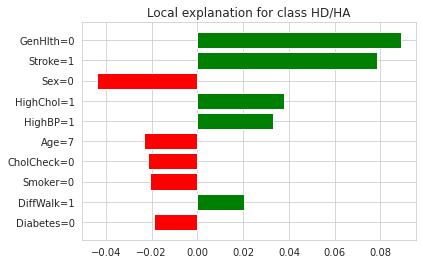

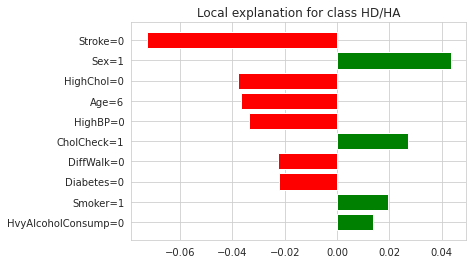

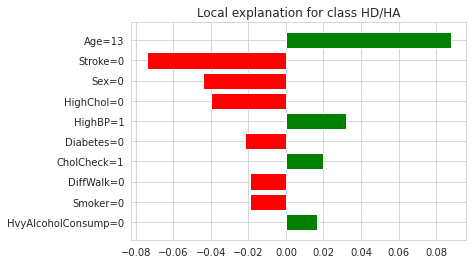

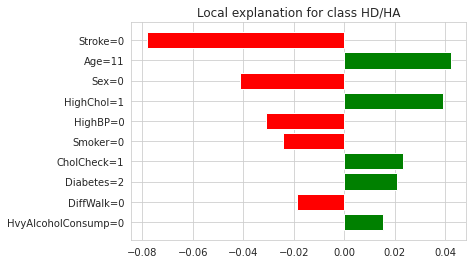

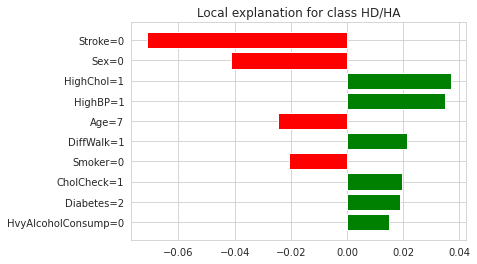

In [ ]:
## Cost-sensitive models

for model in trained_cost_sens_models:
  get_lime_expl(model, lime_explainer, base_X_test, base_y_test)
  get_dice_expl(model, dice_data, base_X_test, base_y_test)

Intercept 0.4557394156555491
Prediction_local [0.43970315]
Right: 0.5475061472941383
Observation features:  [ 0.  1.  1.  0.  0.  2.  1.  0.  1.  0.  1.  0.  2.  0.  0.  0.  0. 11.
  5.  3.  1.]
Actual label:  0.0
Predicted label:  [1.]


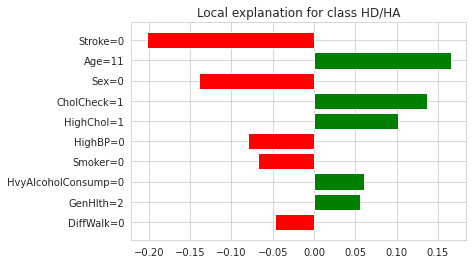

In [ ]:
## For individual models - LIME
test_index = 3
model = trained_oversampling_models[0]

exp = lime_explainer.explain_instance(base_X_test[test_index],
     model.predict_proba, num_features=10)
exp.as_pyplot_figure();

print('Observation features: ', base_X_test[test_index])
print('Actual label: ', base_y_test[test_index])
print('Predicted label: ', model.predict(base_X_test[test_index].reshape(1,-1)))

exp.show_in_notebook(show_table=True, show_all=False)

#print(scaler.inverse_transform(base_X_test[1].reshape(1,-1)))
#model.predict_proba(base_X_test[0].reshape(1,-1))

In [ ]:
## For individual models - DiCE

test_index = 4
model = trained_oversampling_models[0]

## List of features to vary - limit to immediately actionable features
non_actionable = ['Stroke', 'Diabetes', 'Sex', 'Age']
non_actionable_strict = ['Stroke', 'Diabetes', 'Sex', 'Age', 'Smoker', 'HighBP', 'HighChol']
possibly_actionable = ['CholCheck', 'AnyHealthcare', 'NoDocbcCost', 'GenHlth', 'MentHlth', \
                        'PhysHlth', 'DiffWalk', 'Education', 'Income']

#feats_vary = [feat for feat in X_col_names if feat not in non_actionable]
feats_vary = [feat for feat in X_col_names if feat not in non_actionable and feat not in possibly_actionable]

#feats_vary = [feat for feat in X_col_names if feat not in non_actionable_strict]
#feats_vary = [feat for feat in X_col_names if feat not in non_actionable_strict and feat not in possibly_actionable]

dice_model = dice_ml.Model(model=model, backend="sklearn")

explainer = dice_ml.Dice(dice_data, dice_model, method="random")

# Put X_test into pandas dataframe
X_test_df = pd.DataFrame(base_X_test)
X_test_df.columns = X_col_names

exp = explainer.generate_counterfactuals(X_test_df[test_index:test_index+1], total_CFs=10, desired_class='opposite', \
                                          features_to_vary=feats_vary)

print('\nActual label: ', base_y_test[test_index])
exp.visualize_as_dataframe(show_only_changes=True)

100%|██████████| 1/1 [00:00<00:00,  2.64it/s]


Actual label:  1.0
Query instance (original outcome : 0)


,HighBP,HighChol,CholCheck,Smoker,Stroke,Diabetes,PhysActivity,Fruits,Veggies,HvyAlcoholConsump,AnyHealthcare,NoDocbcCost,GenHlth,MentHlth,PhysHlth,DiffWalk,Sex,Age,Education,Income,BMICat,HeartDiseaseorAttack
0,1.00,1.00,1.00,0.00,0.00,2.00,1.00,0.00,1.00,0.00,0.00,1.00,2.00,0.00,0.00,1.00,0.00,7.00,4.00,6.00,3.00,0



Diverse Counterfactual set (new outcome: 1.0)


,HighBP,HighChol,CholCheck,Smoker,Stroke,Diabetes,PhysActivity,Fruits,Veggies,HvyAlcoholConsump,AnyHealthcare,NoDocbcCost,GenHlth,MentHlth,PhysHlth,DiffWalk,Sex,Age,Education,Income,BMICat,HeartDiseaseorAttack
0,-,-,-,1.0,-,-,-,-,0.0,-,-,-,-,-,-,-,-,-,-,-,0.0,1.0
1,-,-,-,1.0,-,-,0.0,1.0,-,-,-,-,-,-,-,-,-,-,-,-,-,1.0
2,-,-,-,1.0,-,-,-,-,0.0,-,-,-,-,-,-,-,-,-,-,-,-,1.0
3,-,-,-,1.0,-,-,0.0,-,-,-,-,-,-,-,-,-,-,-,-,-,1.0,1.0
4,-,-,-,1.0,-,-,-,1.0,-,-,-,-,-,-,-,-,-,-,-,-,5.0,1.0
5,-,-,-,1.0,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,1.0,1.0
6,-,-,-,1.0,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,2.0,1.0
7,-,-,-,1.0,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,4.0,1.0
8,-,-,-,1.0,-,-,0.0,-,-,-,-,-,-,-,-,-,-,-,-,-,-,1.0
9,-,-,-,1.0,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,0.0,1.0
